### MST, minimum cost 구하는 부분

In [1]:
parent = {}
rank = {}

# 정점을 독립적인 집합으로 만든다.
def make_set(v):
    parent[v] = v
    rank[v] = 0

# 해당 정점의 최상위 정점을 찾는다.
def find(v):
    if parent[v] != v:
        parent[v] = find(parent[v])
        
    return parent[v]

# 두 정점을 연결한다.
def union(v, u):
    root1 = find(v)
    root2 = find(u)
    
    if root1 != root2:
        # 짧은 트리의 루트가 긴 트리의 루트를 가리키게 만드는 것이 좋다.
        if rank[root1] > rank[root2]:
            parent[root2] = root1
        else:
            parent[root1] = root2
            
            if rank[root1] == rank[root2]:
                rank[root2] += 1

def getMST(n, edges):    
    for i in range(n):
        make_set(i)
    cost = 0
    mst = []
    edges.sort(key = lambda x : x[2])
    
    for edge in edges:
        v, u, weight = edge
        if find(v) != find(u):
            union(v, u)
            mst.append(edge)
            cost += weight
    return mst, cost

### 트리의 지름 구하는 부분

In [2]:
import sys

def dfs(data, visited, index):
    visited[index] = True
    d_list = []
    h_list = []
    for v, w in data[index]:
        if v in visited:
            continue

        diameter, height = dfs(data, visited, v)
        d_list.append(diameter) # sub d
        h_list.append(height + w) # sub h

    # print(d_list, h_list)
    # 1) sub tree 의 diameter가 현재 tree 의 diameter다
    # 1) sub tree 의 height 로 만든 diameter 가 현재 tree 의 diameter다
    if len(h_list) == 0 and len(d_list) == 0:
        return 0, 0

    h_list = sorted(h_list, reverse=True)
    max_d = max(d_list)
    if len(h_list) >= 2:
        max_cand_d = h_list[0] + h_list[1]
        if max_d < max_cand_d:
            max_d = max_cand_d

    return max_d, h_list[0]

def getDiameter(data):
    visited = dict()
    d, h = dfs(data, visited, 0)
    return max(d, h)

def edgesToTree(n, edges):
    tree = {}
    for i in range(n):
        tree[i] = list()
    for s, e, cost in edges:
        tree[s].append((e, cost))
        tree[e].append((s, cost))
    return tree

### 테스트 케이스 생성

Generating 0...
N =  372
K =  34485
Generating 1...
N =  406
K =  41124
Generating 2...
N =  867
K =  187202
Generating 3...
N =  951
K =  225544
Generating 4...
N =  736
K =  134909
Generating 5...
N =  434
K =  47204
Generating 6...
N =  856
K =  183096
Generating 7...
N =  886
K =  195674
Generating 8...
N =  745
K =  138580
Generating 9...
N =  144
K =  5172
Generating 10...
N =  645


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


K =  103740
Generating 11...
N =  802
K =  160649
Generating 12...
N =  243
K =  14775
Generating 13...
N =  415
K =  42774
Generating 14...
N =  674
K =  113203
Generating 15...
N =  928
K =  214722
Generating 16...
N =  703
K =  122784
Generating 17...
N =  821
K =  168424
Generating 18...
N =  782
K =  152629
Generating 19...
N =  337
K =  28476
Generating 20...
N =  317
K =  24960
Generating 21...
N =  948
K =  224245
Generating 22...
N =  108
K =  2983
Generating 23...
N =  793
K =  156810
Generating 24...
N =  765
K =  145739
Generating 25...
N =  932
K =  217191
Generating 26...
N =  554
K =  76245
Generating 27...
N =  479
K =  57117
Generating 28...
N =  775
K =  149553
Generating 29...
N =  464
K =  53835
Generating 30...
N =  788
K =  154922
Generating 31...
N =  321
K =  25563
Generating 32...
N =  489
K =  59677
Generating 33...
N =  196
K =  9524
Generating 34...
N =  879
K =  193119
Generating 35...
N =  375
K =  35092
Generating 36...
N =  761
K =  144544
Generating 37.

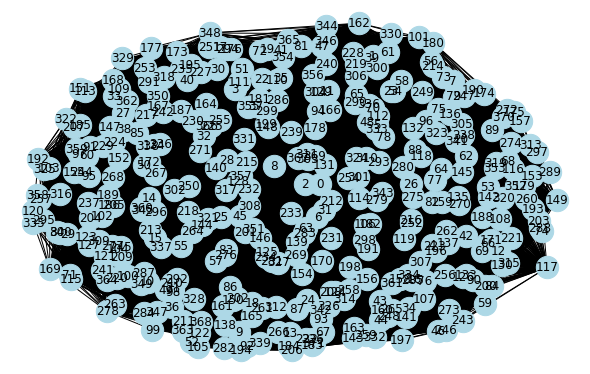

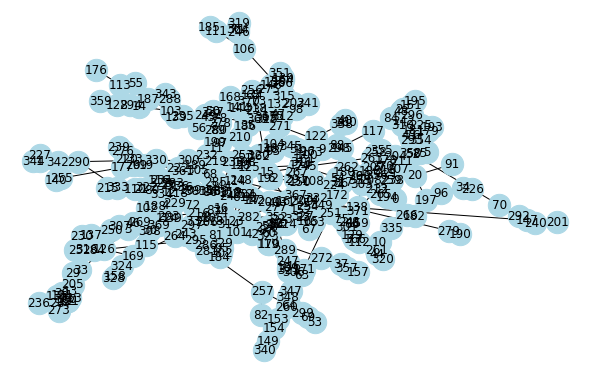

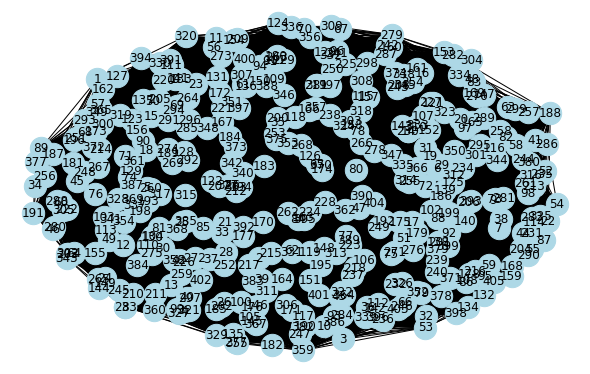

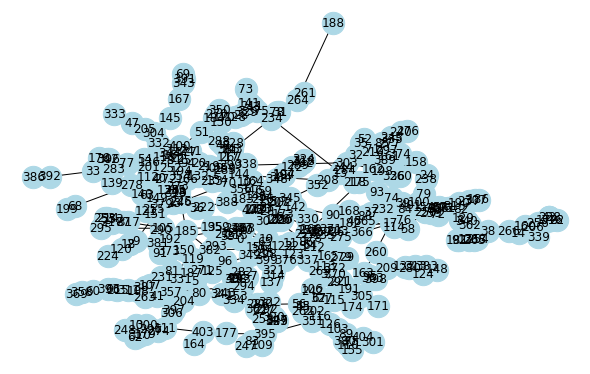

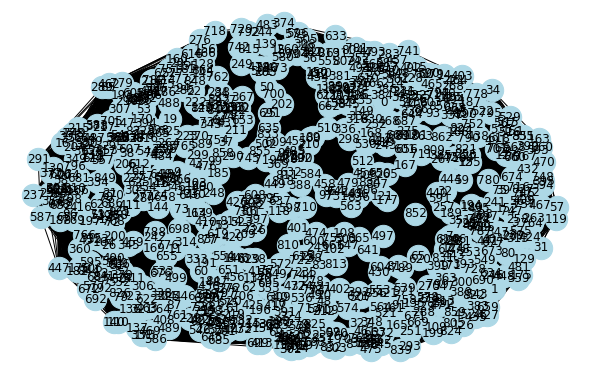

...

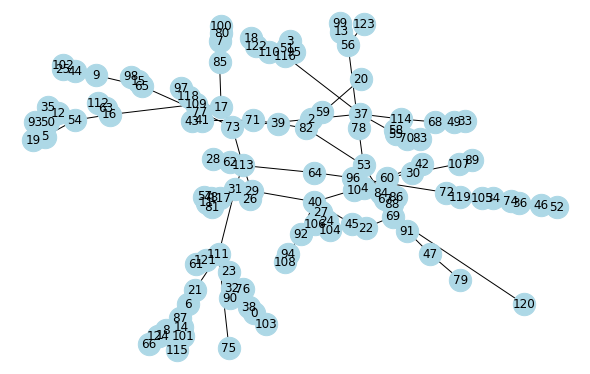

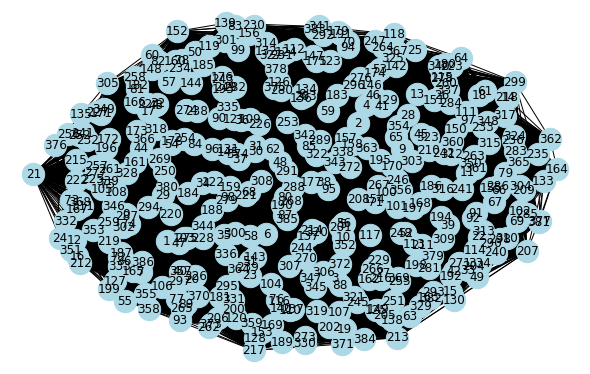

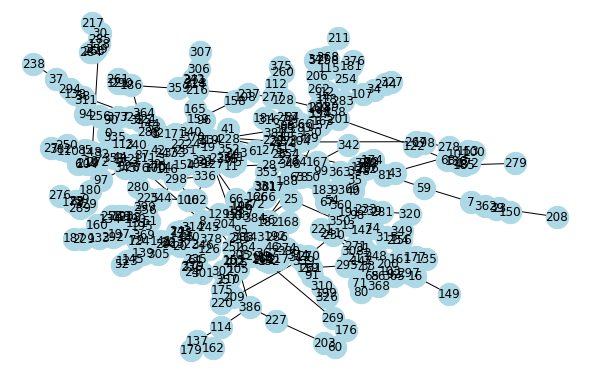

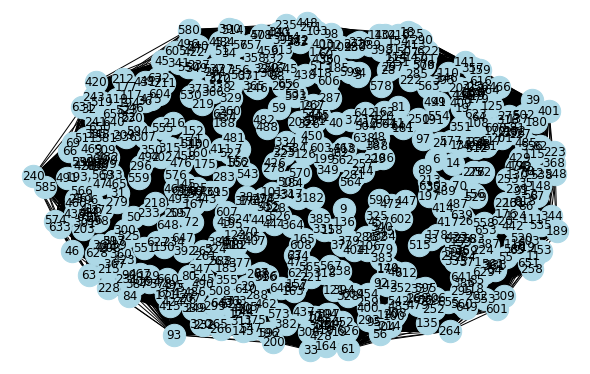

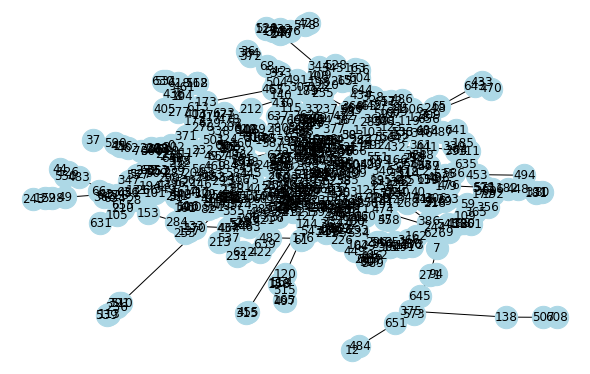

In [3]:
import networkx as nx
import random
import matplotlib.pyplot as plt
from IPython.display import clear_output


for i in range(50):
    print('Generating {}...'.format(i))
    # 그래프 생성
    N = random.randint(100, 1000)
    P = 0.5
    print('N = ', N)
    G = nx.gnp_random_graph(N, P)
    while nx.is_connected(G) == False:
        G = nx.gnp_random_graph(N, P)
    plt.figure(figsize=(8,5))
    nx.draw(G, node_color='lightblue',
            with_labels=True,
            node_size=500)

    # x.in 생성
    K = len(G.edges)
    print('K = ', K)
    costs = []
    f = open('./data/' + str(i) + '.in', 'wt')
    # print('======= TEST CASE ======')
    f.write('{} {}\n'.format(N, K))
    cost_pool = [i for i in range(1, N * N + 1)]
    random.shuffle(cost_pool)
    for s, e in G.edges:
        cost = cost_pool.pop()
        # print(s, e, cost)
        f.write('{} {} {}\n'.format(s, e, cost))
        elem = [s, e, cost]
        costs.append(elem)
    f.close()
    # x.out 생성
    f = open('./data/' + str(i) + '.out', 'wt')
    mst, cost = getMST(N, costs)
    tree = edgesToTree(N, mst)
    diameter = getDiameter(tree)
    # print('=== cost, mst, tree ==')
    # print(cost)
    # print(diameter)
    f.write(str(cost) + '\n')
    f.write(str(diameter) + '\n')
    f.close()
    G=nx.Graph()
    G.add_weighted_edges_from(mst)
    plt.figure(figsize=(8,5))
    nx.draw(G, node_color='lightblue',
            with_labels=True,
            node_size=500)

In [6]:
import sys

def dfs(data, visited, index):
    visited[index] = True
    d_list = []
    h_list = []
    for v, w in data[index]:
        if v in visited:
            continue

        diameter, height = dfs(data, visited, v)
        d_list.append(diameter) # sub d
        h_list.append(height + w) # sub h

    # print(d_list, h_list)
    # 1) sub tree 의 diameter가 현재 tree 의 diameter다
    # 1) sub tree 의 height 로 만든 diameter 가 현재 tree 의 diameter다
    if len(h_list) == 0 and len(d_list) == 0:
        return 0, 0

    h_list = sorted(h_list, reverse=True)
    max_d = max(d_list)
    if len(h_list) >= 2:
        max_cand_d = h_list[0] + h_list[1]
        if max_d < max_cand_d:
            max_d = max_cand_d

    return max_d, h_list[0]

def getDiameter(data):
    visited = dict()
    d, h = dfs(data, visited, 0)
    return max(d, h)

def edgesToTree(n, edges):
    tree = {}
    for i in range(n):
        tree[i] = list()
    for s, e, cost in edges:
        tree[s].append((e, cost))
        tree[e].append((s, cost))
    return tree

def solver():
    costs = []
    N, M = [int(num) for num in input().split()]
    for i in range(M):
        s, e, cost = [int(num) for num in input().split()]
        costs.append([s, e, cost])
    mst, cost = getMST(N, costs)
    tree = edgesToTree(N, mst)
    diameter = getDiameter(tree)
    print(cost)
    print(diameter)

In [5]:
solver()

7 12
0 1 8
0 3 10
0 5 4
0 6 5
1 5 5
2 3 8
2 4 8
2 5 4
2 6 1
3 4 4
4 6 9
5 6 5
d, h 21 20
26
21
